In [450]:
import numpy as np
import pandas as pd
import matplotlib as mpl

In [451]:
kb = pd.read_csv('./data.csv.zip')

## 1: Overview

### 1.1: Let's start with a quick overview of the data

In [452]:
kb.head()

,action_type,combined_shot_type,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,...,shot_type,shot_zone_area,shot_zone_basic,shot_zone_range,team_id,team_name,game_date,matchup,opponent,shot_id
0,Jump Shot,Jump Shot,10,20000012,33.9723,167,72,-118.1028,10,1,...,2PT Field Goal,Right Side(R),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,1
1,Jump Shot,Jump Shot,12,20000012,34.0443,-157,0,-118.4268,10,1,...,2PT Field Goal,Left Side(L),Mid-Range,8-16 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,2
2,Jump Shot,Jump Shot,35,20000012,33.9093,-101,135,-118.3708,7,1,...,2PT Field Goal,Left Side Center(LC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,3
3,Jump Shot,Jump Shot,43,20000012,33.8693,138,175,-118.1318,6,1,...,2PT Field Goal,Right Side Center(RC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,4
4,Driving Dunk Shot,Dunk,155,20000012,34.0443,0,0,-118.2698,6,2,...,2PT Field Goal,Center(C),Restricted Area,Less Than 8 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,5


In [453]:
kb.shape

(30697, 25)

From the looks of our above table, we have some locational data, a fair number of categorical features, and the respresentation of id-based features, which are unlikely to be used later on. We seem to have a good number of total observations (not big data, but small data constrictions are unlikely). 

### 1.2: How about missing values?

In [454]:
kb.isna().sum().sum()

5000

In [455]:
kb.isna().sum().sort_values(ascending = False).head(2)

shot_made_flag    5000
shot_id              0
dtype: int64

We have 5000 missing values total; as stated in the Kaggle description, this is our test set, so we'll be sure to extract them. 

In other words, we will not have any missing values once the split occurs.

### 1.3: Misleading Values

In [456]:
kb.describe()

,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,playoffs,seconds_remaining,shot_distance,shot_made_flag,team_id,shot_id
count,30697.000000,3.069700e+04,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,25697.000000,3.069700e+04,30697.000000
mean,249.190800,2.476407e+07,33.953192,7.110499,91.107535,-118.262690,4.885624,2.519432,0.146562,28.365085,13.437437,0.446161,1.610613e+09,15349.000000
std,150.003712,7.755175e+06,0.087791,110.124578,87.791361,0.110125,3.449897,1.153665,0.353674,17.478949,9.374189,0.497103,0.000000e+00,8861.604943
min,2.000000,2.000001e+07,33.253300,-250.000000,-44.000000,-118.519800,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.610613e+09,1.000000
25%,110.000000,2.050008e+07,33.884300,-68.000000,4.000000,-118.337800,2.000000,1.000000,0.000000,13.000000,5.000000,0.000000,1.610613e+09,7675.000000
50%,253.000000,2.090035e+07,33.970300,0.000000,74.000000,-118.269800,5.000000,3.000000,0.000000,28.000000,15.000000,0.000000,1.610613e+09,15349.000000
75%,368.000000,2.960047e+07,34.040300,95.000000,160.000000,-118.174800,8.000000,3.000000,0.000000,43.000000,21.000000,1.000000,1.610613e+09,23023.000000
max,659.000000,4.990009e+07,34.088300,248.000000,791.000000,-118.021800,11.000000,7.000000,1.000000,59.000000,79.000000,1.000000,1.610613e+09,30697.000000


We're looking at the numeric features to find any potential outliers. This also gives us a good look at them in general. Most don't provide much relevant information; the id-based features pollute this section, and there are a few binary features that should be considered as categorical. 


An interesting result to note: the shot_distance attributed have a minimum value of 0. This could realistically happen (shots made as dunks and the like), but I want to make sure that they aren't standins for missing values.

### 1.4: Physical Distribution of Shots

In [457]:
import matplotlib.pyplot as plt 
import seaborn as sns

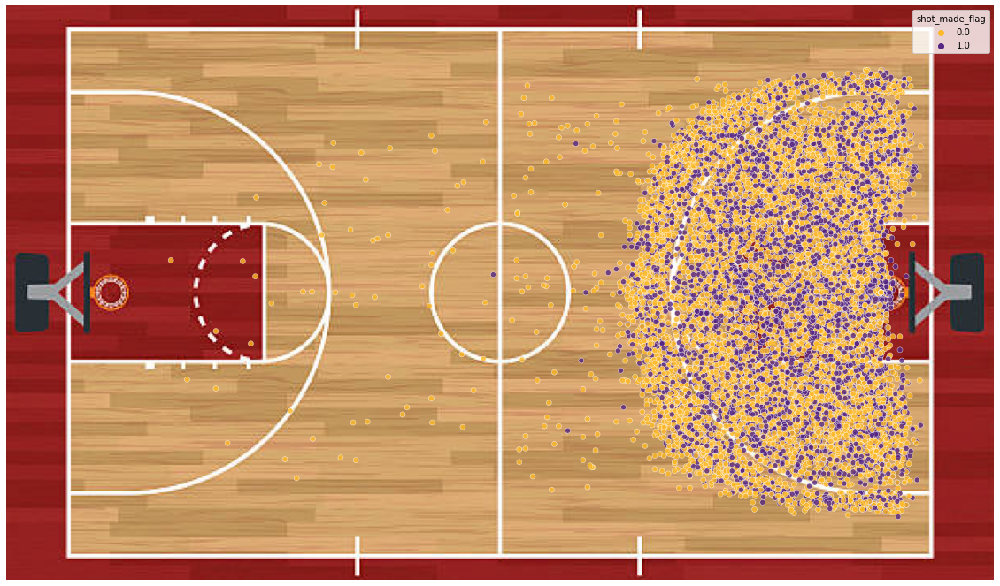

In [458]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_made_flag', alpha = 0.8, palette = pal);

This is the career of a professional basketball player visualized. 

Purely based on observation, it seems that Kobe performed the majority of his shots from within the three-point line. It also looks like there is no clear relationship between his successful shots and where along the extended free throw line he was (i.e his location along the y-axis did not seem to matter). 

### 1.5: The Target Feature

In [459]:
kb.shot_made_flag.value_counts()

0.0    14232
1.0    11465
Name: shot_made_flag, dtype: int64

Ignoring the observations in the test set, it seems that Kobe missed slightly more shots than he made, averaging around a 44.6% shot completion rate. As is expected, the target feature calls for binary classification, and there is no need for any form of transformation.

## 2: Splitting the Data

### 2.1: Separate Testing Set Based on Aforementioned Kaggle Requirements

In [460]:
## Find observations with missing shot_made_flag values
test_index = kb[kb.shot_made_flag != kb.shot_made_flag].index

## split between overall train and testing sets
train = kb.drop(index=test_index)
test = kb.loc[test_index]

## Break further into X and y for each
X, y = train.drop(['shot_made_flag'], axis = 1), train.shot_made_flag
Xte, yte = test.drop(['shot_made_flag'], axis = 1), test.shot_made_flag

### 2.2: Split Remaining Observations into Training and Validation Sets

In [461]:
from sklearn.model_selection import train_test_split
Xtr, Xval, ytr, yval = train_test_split(X, y, test_size = 0.3, random_state = 1)

Now that we have our training, testing, and validation sets, we can safely perform some EDA.

## 3: Exploratory Data Analysis (EDA)

### 3.1: Shot Distance

Let's look at my prior concerns about potential irregularities in the shot_distance feature. 

Remember that the lowest value was zero, which I was worried may have been a standin for a missing value. That said, it is more likely that these values represent dunks made by Kobe. We'll be making sure. 

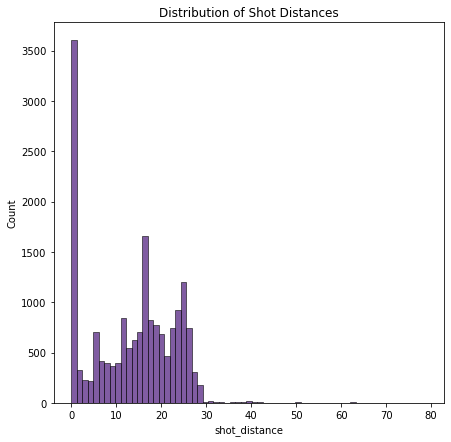

In [462]:
plt.figure(figsize=(7,7))
sns.histplot(Xtr.shot_distance)
plt.title("Distribution of Shot Distances");

Its clear that most of the our shots occurred from at the net. These can include dunks, layups, and close shots. Let's get a little bit of accounting done.

In [463]:
Xtr['action_type'].value_counts().head(10)

Jump Shot                   11132
Layup Shot                   1501
Driving Layup Shot           1148
Turnaround Jump Shot          614
Fadeaway Jump Shot            609
Running Jump Shot             509
Pullup Jump shot              293
Turnaround Fadeaway shot      261
Reverse Layup Shot            241
Slam Dunk Shot                237
Name: action_type, dtype: int64

In [464]:
#Our dunks
Xtr['action_type'][Xtr['action_type'].str.contains('Dunk')].value_counts().sum()

727

In [465]:
# Our layups
Xtr['action_type'][Xtr['action_type'].str.contains('Layup')].value_counts().sum()

3112

Although I didn't specifically account for each observation with a shot range of 0, seeing this, along with the physical distribution of shots, you can tell that those values are genuine rather than missing.

How does the shot's distance relate to its scoring chance?

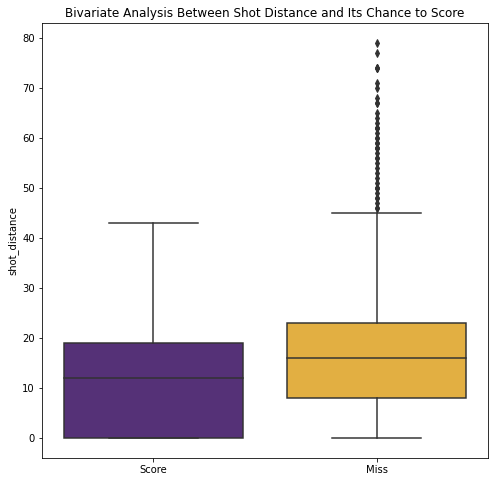

In [466]:
plt.figure(figsize=(8,8))
sns.boxplot(x = np.where(ytr == 1, 'Score', 'Miss'), y = Xtr.shot_distance)
plt.title('Bivariate Analysis Between Shot Distance and Its Chance to Score');

You could likely guess that a shot's distance influenced whether or not it would be a field goal or miss. This boxplot just confirms that relationship.

### 3.2: Action Type vs Combined Shot Type

Next up we have two categorical features; at first blush, action shot and shot type seem very similar since both essentially describe the type of shot performed by Kobe. If they do overlap to this degree, then we'll need to choose one or the other later on.

Let's look at both:

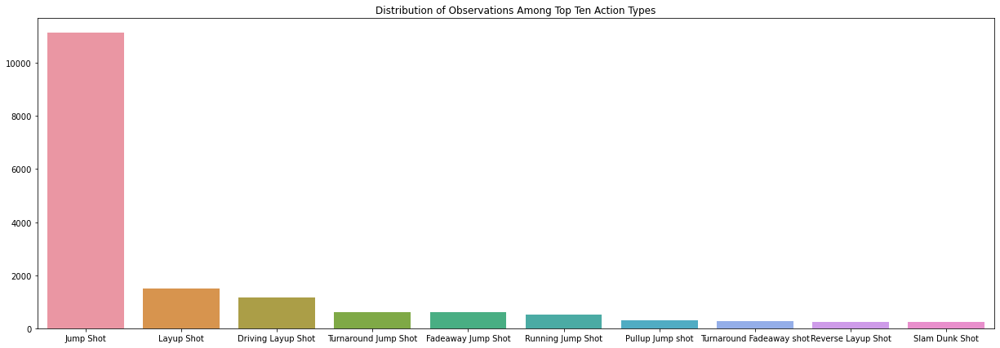

In [467]:
temp = Xtr.action_type.value_counts().sort_values(ascending = False).head(10)
plt.figure(figsize = (21,7))
sns.barplot(x = temp.index, y = list(temp))
plt.title("Distribution of Observations Among Top Ten Action Types");

From this point onwards, the distribution becomes more skewed until we get to categories that consist of one observations. This is a paretto distribution in a nutshell. 

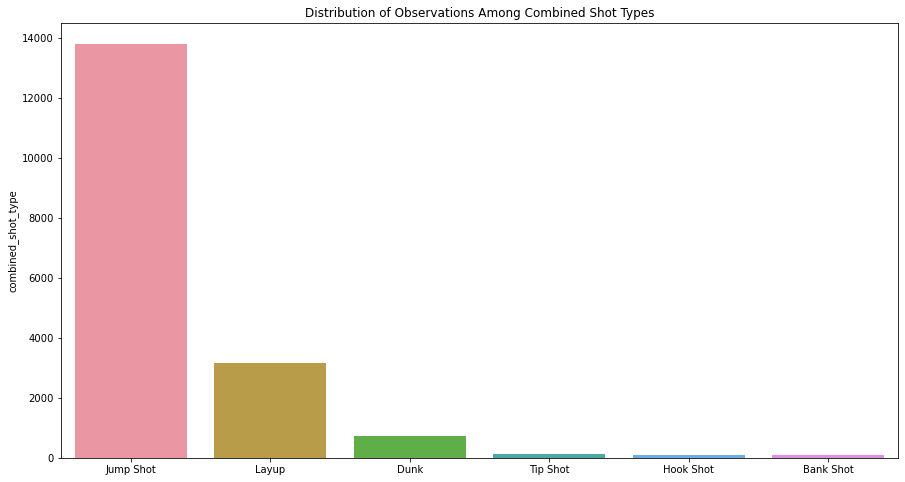

In [468]:
temp = Xtr.combined_shot_type.value_counts().sort_values(ascending = False)

plt.figure(figsize = (15,8))
sns.barplot(x = temp.index, y = temp)
plt.title('Distribution of Observations Among Combined Shot Types');

As the feature name suggests, this attribute combines the categories of the prior setup. 


This means that there is significant overlap between the two; we will need to look at both's relationship with the target feature before picking one or the other.

In [469]:
pd.crosstab(index = Xtr.action_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False).head(10)

col_0,Miss,Score
action_type,,
Jump Shot,7504,3628
Driving Layup Shot,299,849
Layup Shot,927,574
Running Jump Shot,119,390
Turnaround Jump Shot,244,370
Fadeaway Jump Shot,261,348
Slam Dunk Shot,5,232
Pullup Jump shot,78,215
Driving Dunk Shot,3,172


Although it is difficult to see and calculate all of these categories (there are over fifty of them), they do a great job in discriminating between shots that miss and those that do not. 

For example, you can be reasonably sure that a driving layup shot would score; on the other hand, the combined shot type variable below aggregate layups into one category, which is far more mixed. The granularity of the prior's categories make it a more powerful option.

In [470]:
pd.crosstab(index = Xtr.combined_shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
combined_shot_type,,
Jump Shot,8423,5386
Layup,1386,1786
Dunk,55,672
Bank Shot,21,56
Hook Shot,41,47
Tip Shot,74,40


### 3.3: Shot Type

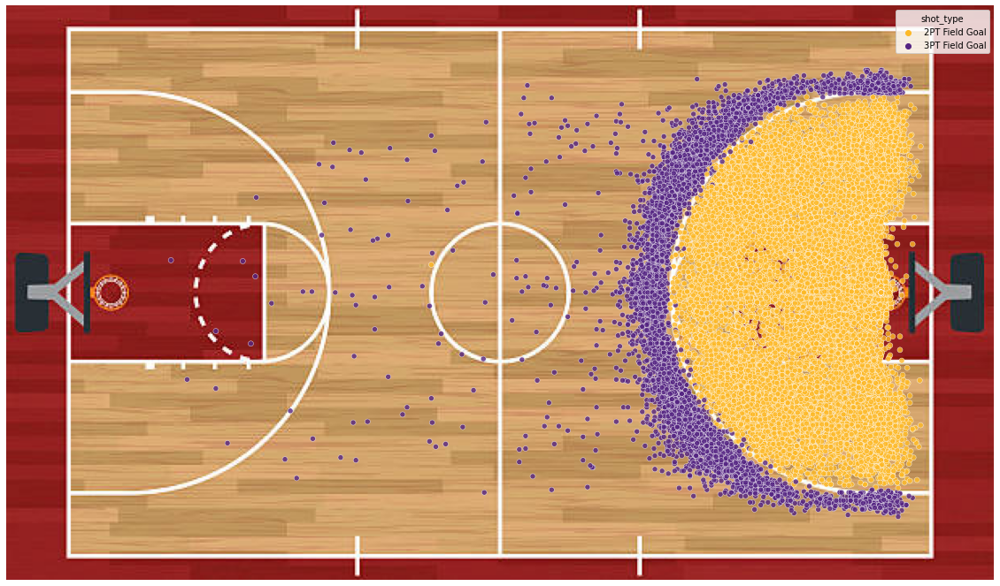

In [471]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_type', alpha = 0.8, palette = pal);

In [472]:
pd.crosstab(index = Xtr.shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_type,,
2PT Field Goal,7396,6700
3PT Field Goal,2604,1287


I'm bringing back our prior image to showcase this feature. 

Although there is a clear connection between the type of shot made and its percent chance to become a field goal, there is also a relationship between it and the shot distance showcased earlier. The two features are covariant, meaning this feature will be dropped later on.

### 3.4: Shot Zone Area

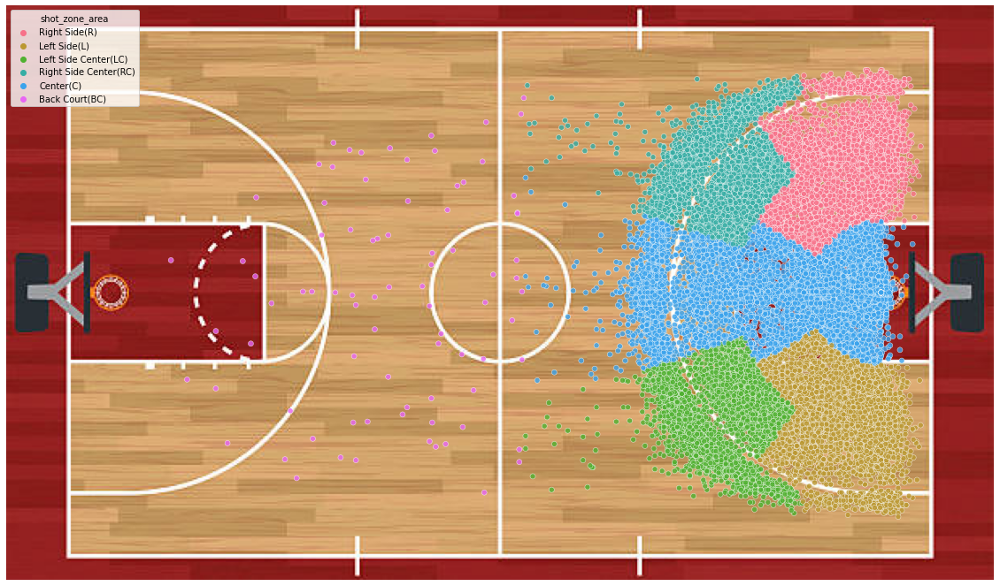

In [473]:
# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_zone_area', alpha = 0.8);

In [474]:
pd.crosstab(index = Xtr.shot_zone_area, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_zone_area,,
Center(C),3774,4134
Right Side(R),1597,1083
Right Side Center(RC),1712,1076
Left Side Center(LC),1560,848
Left Side(L),1305,845
Back Court(BC),52,1


Although this feature suffers from the same potential for covariance with shot distance that shot type did, this variable differentiates itself by incorporating the shot angle into the equation. 

For example, it's clear that Kobe managed greater success when shooting from the center rather than the left or right, despite the fact that they (mostly) were taken from comparable ranges. Since there is no shot angle attribute, we should keep shot zone area as a supplement. 

## 4: Feature Engineering and Selection

Although we've run through and selected (or disqualified) a few features, those decisions were pretty straightforward, and they were direct byproducts of my exploratory data analysis. In this next section, we will be looking through other attributes that either need to be altered or have a more complicated relationship with others in the set.

### 4.1: Season

In [475]:
Xtr.season.head()

11204    2006-07
18720    2011-12
750      2000-01
4490     2002-03
15592    2009-10
Name: season, dtype: object

As you can see, the season feature represents a range of time rather than the specific year. Primarily, this has to do with when the games take place; since basketball starts late in the year, some find it difficult to ID the season as belonging to one year or another. 

I'm going to turn this ranged value into an integer representing the prior year (Ex. 2005-06 becomes 2005). This allows the data to be represented in an easier fashion.

In [476]:
def season_integer(df):
    df.season = pd.to_numeric(df.season.str.replace('-..', '', regex = True))
    return df

temp = pd.to_numeric(Xtr.season.str.replace('-..', '', regex = True))
temp.head()

11204    2006
18720    2011
750      2000
4490     2002
15592    2009
Name: season, dtype: int64

Now that we've fixed that problem, let's see how the season correlates with the shot completion rate.

In [477]:
tempy = pd.crosstab(index = temp, columns = np.where(ytr == 1, 'Score', 'Miss'))
tempy['Ratio'] = tempy['Score']/(tempy['Miss'] + tempy['Score'])
tempy.Ratio.describe()

count    20.000000
mean      0.438243
std       0.032334
min       0.352665
25%       0.426512
50%       0.448060
75%       0.459386
max       0.478102
Name: Ratio, dtype: float64

In [478]:
tempy.sort_values(by = 'Ratio',ascending = False).head()

col_0,Miss,Score,Ratio
season,,,
2000,572,524,0.478102
2007,689,608,0.468774
1999,495,436,0.468314
2006,584,506,0.464220
1998,297,256,0.462929


It seems that the late-90s and early 2000s were pretty good years for Kobe. Let's see how this looks on a grander scale.

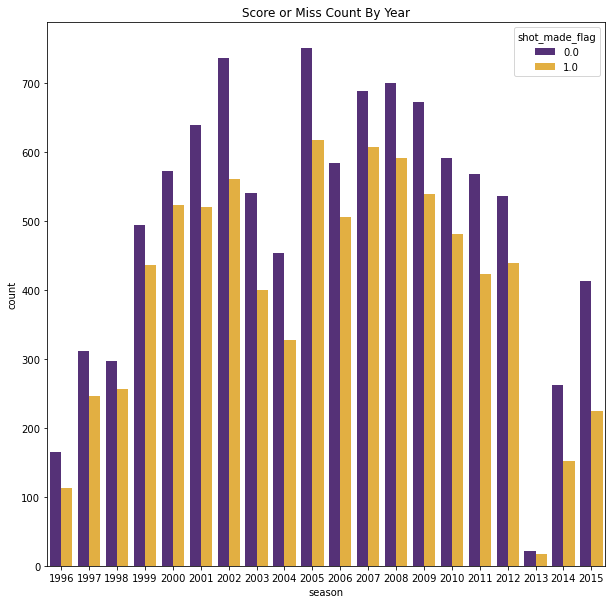

In [479]:
plt.figure(figsize = (10,10))
sns.countplot(x = temp, hue = ytr)
plt.title('Score or Miss Count By Year');

The season feature shows how Kobe's game had changed over the years. Its clear from the visualization and the summary statistics shown above that the star's performance changed over time with his shot percentage shifting over the years. 

I'm going to check if transforming the seasons feature into a true continuous variable (rather than a year, which can really be either) can result in a stronger predictor. How has Kobe's performance changed over time since he joined the NBA counted by days?

In [480]:
temp = Xtr.game_date.str.split('-').explode()
temp = pd.DataFrame(temp.groupby(level = 0).apply(list))
Xtr['game_date_days'] = temp['game_date'].apply(lambda rowval: (int(rowval[0])*365)+(int(rowval[1]) * 30)+(int(rowval[2])) - 728873).sort_values(ascending = False)

<ipython-input-480-ae78a71938ab>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Xtr['game_date_days'] = temp['game_date'].apply(lambda rowval: (int(rowval[0])*365)+(int(rowval[1]) * 30)+(int(rowval[2])) - 728873).sort_values(ascending = False)


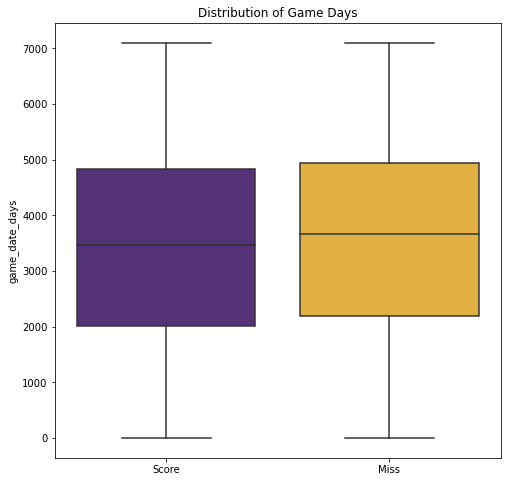

In [481]:
miss_index = ytr[ytr == 0].index

plt.figure(figsize = (8,8))
sns.boxplot(x = np.where(ytr == 1, 'Score', 'Miss'), y = Xtr['game_date_days'])
plt.title("Distribution of Game Days");

Turns out, this was a terrible discriminator. With that being said, it was worth a try. We'll stick with the season variable.

### 4.2: What About Playoffs?

In [482]:
temp = pd.crosstab(index = Xtr.playoffs, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp

col_0,Miss,Score,Ratio
playoffs,,,
0,8543,6816,0.443779
1,1457,1171,0.445586


Generally, Kobe didn't seem to be affected by playoff pressure. These results would push us towards getting rid of the featureas a predictive variable. What happens if we break it down by year? 

In [483]:
temp = pd.concat((Xtr[['game_date','playoffs']], ytr), axis = 1)
temp['game_date'] = pd.to_datetime(temp['game_date'])
temp['counts'] = temp.groupby(['game_date','playoffs','shot_made_flag'])['game_date'].transform('size')
temp['norm_counts'] = temp.groupby(['game_date'])['game_date'].transform('size')

temp.sort_values(by = ['game_date']).head()

,game_date,playoffs,shot_made_flag,counts,norm_counts
22901,1996-11-03,0,0.0,1,1
22902,1996-11-05,0,0.0,1,1
22905,1996-11-06,0,1.0,2,2
22903,1996-11-06,0,1.0,2,2
22911,1996-11-08,0,0.0,3,5


In [484]:
tempy = temp[['game_date', 'norm_counts']].sort_values(by = ['game_date']).drop_duplicates()
tempy.head()

,game_date,norm_counts
22901,1996-11-03,1
22902,1996-11-05,1
22905,1996-11-06,2
22911,1996-11-08,5
22914,1996-11-10,2


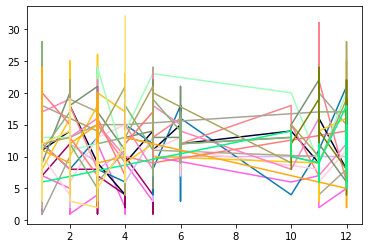

In [485]:
# tempy['year'] = tempy['game_date'].dt.year
# tempy['month'] = tempy['game_date'].dt.month


# years = tempy['year'].unique()
# mycolors = np.random.choice(list(mpl.colors.XKCD_COLORS.keys()), len(years), replace=False)


# for i, ye in enumerate(years):
#     if i >0:
#         plt.plot('month','norm_counts', data = tempy.loc[tempy.year == ye,:], label = ye, color = mycolors[i])


<AxesSubplot:xlabel='game_date', ylabel='counts'>

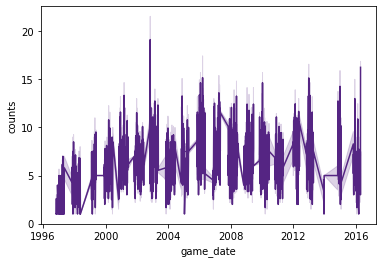

In [486]:
sns.lineplot(x = 'game_date', y = 'counts', data = temp)

### 4.3: In-Game Temporal Features

In [487]:
temp = Xtr[['minutes_remaining','period','seconds_remaining']]
temp.head()

,minutes_remaining,period,seconds_remaining
11204,2,2,48
18720,3,4,19
750,4,4,42
4490,3,2,52
15592,7,2,6


Our next features are all connected in that they describe the points during individual games that Kobe made or missed a shot. What's interesting about these features is that there is an argument to both combine them into one overall clock and not to. 

For: Combinging them all into one would allow us to track shots continuously throughout the game.
Against: This is not exactly how basketball works; shots are more likely to happen as the timer runs down, especially as the number of periods drags on. A continuous clock would falter when explaining hopeful shots just before halftime.

Continuous intervals interrupted by quarter starts and stops seems to be the best way forward. I will merge the minutes and seconds features into one but leave the quarter variable alone. 

In [488]:
temp['game_time'] = (pd.to_numeric(temp['minutes_remaining'])*60)+(pd.to_numeric(temp['seconds_remaining']))
temp[['minutes_remaining','seconds_remaining','game_time']].head()

<ipython-input-488-caa3800b7a30>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['game_time'] = (pd.to_numeric(temp['minutes_remaining'])*60)+(pd.to_numeric(temp['seconds_remaining']))


,minutes_remaining,seconds_remaining,game_time
11204,2,48,168
18720,3,19,199
750,4,42,282
4490,3,52,232
15592,7,6,426


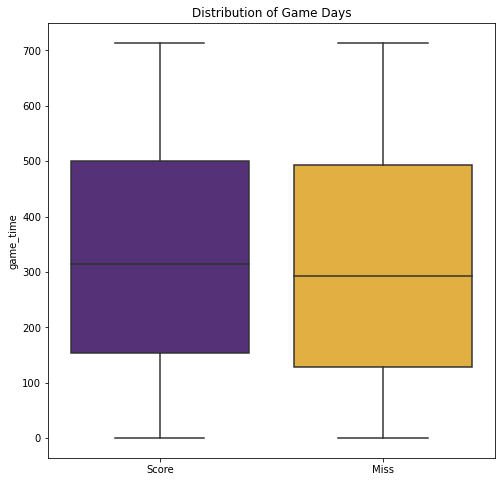

In [489]:
plt.figure(figsize = (8,8))
sns.boxplot(x = np.where(ytr == 1, 'Score', 'Miss'), y = temp['game_time'])
plt.title("Distribution of Game Days");

In [490]:
Xtr.iloc[:,16:]

,shot_zone_basic,shot_zone_range,team_id,team_name,game_date,matchup,opponent,shot_id,game_date_days
11204,Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2007-04-01,LAL vs. SAC,SAC,11205,3803
18720,Above the Break 3,24+ ft.,1610612747,Los Angeles Lakers,2012-02-10,LAL @ NYK,NYK,18721,5577
750,Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2001-01-03,LAL vs. UTA,UTA,751,1525
4490,Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2003-02-28,LAL @ SEA,SEA,4491,2310
15592,Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2010-01-01,LAL vs. SAC,SAC,15593,4808
...,...,...,...,...,...,...,...,...,...
13051,Above the Break 3,24+ ft.,1610612747,Los Angeles Lakers,2008-04-06,LAL @ SAC,SAC,13052,4173
20582,Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2013-02-25,LAL @ DEN,DEN,20583,5957
6187,In The Paint (Non-RA),Less Than 8 ft.,1610612747,Los Angeles Lakers,2004-04-14,LAL @ POR,POR,6188,2721
14552,Above the Break 3,24+ ft.,1610612747,Los Angeles Lakers,2009-03-12,LAL @ SAS,SAS,14553,4514


plt.figure(figsize = (10,10))
sns.countplot(x = temp, hue = ytr)
plt.title('Score or Miss Count By Year');

In [491]:
### 4.4: Opponent

count    33.000000
mean      0.442006
std       0.022663
min       0.398892
25%       0.426593
50%       0.443158
75%       0.460455
max       0.483290
Name: Ratio, dtype: float64

temp = pd.crosstab(index = Xtr.opponent, columns = np.where(ytr == 1, 'Score', 'Miss'))
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp['Ratio'].describe()

The quality of the opposing team is also a theoretical factor for the number of shots Kobe would make versus miss. There is a clear difference between his performance against various teams, meaning the scoring rate could change by up to 10% depending on who Kobe faced. 

With that being said, the standard deviation is not high at all, and most of the range is explained by a few teams that had either performed extremely well or poorly against him.

We'll keep opponents as a predictive feature.

In [492]:
### 4.5: Dropping Features

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [493]:
Xtr.drop(['combined_shot_type','game_event_id','game_id','lat','loc_x','loc_y','lon','shot_zone_range','shot_zone_basic','team_id','team_name','shot_id','matchup','shot_type'], axis = 1, inplace = True)

,action_type,minutes_remaining,period,playoffs,season,seconds_remaining,shot_distance,shot_zone_area,game_date,opponent,game_date_days
11204,Jump Shot,2,2,0,2006-07,48,18,Left Side Center(LC),2007-04-01,SAC,3803
18720,Jump Shot,3,4,0,2011-12,19,24,Left Side Center(LC),2012-02-10,NYK,5577
750,Jump Shot,4,4,0,2000-01,42,18,Right Side(R),2001-01-03,UTA,1525
4490,Jump Shot,3,2,0,2002-03,52,18,Right Side Center(RC),2003-02-28,SEA,2310
15592,Jump Shot,7,2,0,2009-10,6,20,Right Side Center(RC),2010-01-01,SAC,4808
...,...,...,...,...,...,...,...,...,...,...,...
13051,Jump Shot,11,1,0,2007-08,22,24,Right Side Center(RC),2008-04-06,SAC,4173
20582,Jump Shot,3,2,0,2012-13,16,22,Right Side(R),2013-02-25,DEN,5957
6187,Running Hook Shot,1,2,0,2003-04,30,4,Center(C),2004-04-14,POR,2721
14552,Jump Shot,1,4,0,2008-09,46,25,Left Side Center(LC),2009-03-12,SAS,4514


Xtr

# TODO